# EDA

In [1]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import sys
from tqdm import tqdm
import numpy as np
from sklearn.cluster import DBSCAN
import plotly.express as px
import matplotlib.dates as mdates

sys.path.append('../utils')
import helpers as h
import feature_engineering as f

## Declare notebook constants

In [2]:
ITM_DIR = os.path.join(os.getcwd(), '../data/intermediate')

PH = 1100   #Height for plotly (adapt to your screen) #TODO;: implement as JSON config param
PW = 1000   #Width for plotly  (adapt to your screen) #TODO;: implement as JSON config param

## Read parsed data

In [3]:
request_df = pd.read_csv(os.path.join(ITM_DIR, 'clean_data.csv'))

C:\Users\adind\AppData\Local\Temp\ipykernel_9212\291413550.py:1: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  request_df = pd.read_csv(os.path.join(ITM_DIR, 'clean_data.csv'))


## Basic EDA:

In [4]:
request_df.shape

(2120931, 26)

In [5]:
request_df.columns

Index(['file_uuid', 'configurationName', 'id', 'lat', 'long', 'start_time',
       'end_time', 'server_task_number', 'stop_order', 'dir', 'route_id',
       'route_date', 'idblock_1', 'idblock_2', 'idblock_3', 'internal_id',
       'Date', 'Time', 'OptimizationRequestId', 'RouteId', 'TriggerType',
       'ConfigurationName', 'NumberOfTasks', 'NumberOfTasksInInputPlan',
       'request_day_route_order', 'request_day_route_is_last'],
      dtype='object')

In [6]:
request_df[["Date","Time"]].head()

,Date,Time
0,2022-06-17 00:00:00,1900-01-01 05:57:33.231000
1,2022-06-17 00:00:00,1900-01-01 05:57:33.231000
2,2022-06-17 00:00:00,1900-01-01 08:50:02.773000
3,2022-06-17 00:00:00,1900-01-01 08:50:02.773000
4,2022-06-17 00:00:00,1900-01-01 09:24:16.831000


In [7]:
#Date AND Time Conversion
request_df['Date'] = pd.to_datetime(request_df['Date'])
request_df['Time'] = pd.to_datetime(request_df['Time'].str[0:19]).dt.time
# request_df.loc[:, 'Date'] = pd.to_datetime(request_df['Date'], format='%m/%d/%Y')
# request_df.loc[:, 'Time'] = pd.to_datetime(request_df['Time'], format=' %I:%M:%S.%f %p') #weird space in string - hack

In [8]:
request_df[["Date","Time"]].head()

,Date,Time
0,2022-06-17,05:57:33
1,2022-06-17,05:57:33
2,2022-06-17,08:50:02
3,2022-06-17,08:50:02
4,2022-06-17,09:24:16


In [9]:
request_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2120931 entries, 0 to 2120930
Data columns (total 26 columns):
 #   Column                     Dtype         
---  ------                     -----         
 0   file_uuid                  object        
 1   configurationName          object        
 2   id                         object        
 3   lat                        float64       
 4   long                       float64       
 5   start_time                 object        
 6   end_time                   object        
 7   server_task_number         int64         
 8   stop_order                 int64         
 9   dir                        object        
 10  route_id                   object        
 11  route_date                 object        
 12  idblock_1                  int64         
 13  idblock_2                  int64         
 14  idblock_3                  int64         
 15  internal_id                int64         
 16  Date                       datetime6

In [10]:
selection = "0521_621-20220613"
request_df.loc[request_df["dir"] == selection].shape
# request_df.loc[request_df["dir"] == selection].to_excel(f"../data/intermediate/{selection}.xlsx")

(1606, 26)

In [11]:
request_df.loc[request_df["stop_order"] == 1].shape
# request_df.loc[request_df["stop_order"] == 1].to_excel("../data/intermediate/eerstestop.xlsx")

(18010, 26)

In [12]:
request_df["Region_Char"] = request_df["RouteId"].str[5]

In [13]:
request_df.head()

,file_uuid,configurationName,id,lat,long,start_time,end_time,server_task_number,stop_order,dir,...,Time,OptimizationRequestId,RouteId,TriggerType,ConfigurationName,NumberOfTasks,NumberOfTasksInInputPlan,request_day_route_order,request_day_route_is_last,Region_Char
0,41931cd2-8975-4a64-9197-d16abe871bb7,CreateSequence,394,0.565826,0.221868,2022-06-17T07:30:00,2022-06-17T18:00:00,2,1,0521_300-20220617,...,05:57:33,41931cd2-8975-4a64-9197-d16abe871bb7,0521_300,FullOptimization,CreateSequence,2.0,0.0,1.0,False,3
1,41931cd2-8975-4a64-9197-d16abe871bb7,CreateSequence,395,0.565826,0.221868,2022-06-17T08:00:00,2022-06-17T17:00:00,1,2,0521_300-20220617,...,05:57:33,41931cd2-8975-4a64-9197-d16abe871bb7,0521_300,FullOptimization,CreateSequence,2.0,0.0,1.0,False,3
2,5737d4ef-23e9-4832-8bb5-24340a176e31,CreateSequence,384,0.565826,0.221868,2022-06-17T07:30:00,2022-06-17T23:59:00,2,1,0521_300-20220617,...,08:50:02,5737d4ef-23e9-4832-8bb5-24340a176e31,0521_300,FullOptimization,CreateSequence,2.0,0.0,2.0,False,3
3,5737d4ef-23e9-4832-8bb5-24340a176e31,CreateSequence,385,0.565826,0.221868,2022-06-17T08:00:00,2022-06-17T17:00:00,1,2,0521_300-20220617,...,08:50:02,5737d4ef-23e9-4832-8bb5-24340a176e31,0521_300,FullOptimization,CreateSequence,2.0,0.0,2.0,False,3
4,34f409b3-9f92-4720-9926-48ca1cbf6f90,CreateSequence,388,0.572716,0.233306,2022-06-17T07:30:00,2022-06-17T23:59:00,2,1,0521_300-20220617,...,09:24:16,34f409b3-9f92-4720-9926-48ca1cbf6f90,0521_300,FullOptimization,CreateSequence,2.0,0.0,3.0,True,3


### Adinda : Region-Date combinations

In [14]:
regiondate = request_df.groupby(["Region_Char","RouteId","Date","dir"])['dir'].count().reset_index(name='count')
regiondate.shape

(3312, 5)

In [15]:
regiondate.to_excel("../data/intermediate/regiondate.xlsx")

In [16]:
regiondate.head()

,Region_Char,RouteId,Date,dir,count
0,3,0521_300,2022-06-17,0521_300-20220617,6
1,3,0521_301,2022-05-30,0521_301-20220530,154
2,3,0521_301,2022-05-31,0521_301-20220531,1491
3,3,0521_301,2022-06-01,0521_301-20220601,793
4,3,0521_301,2022-06-02,0521_301-20220602,539


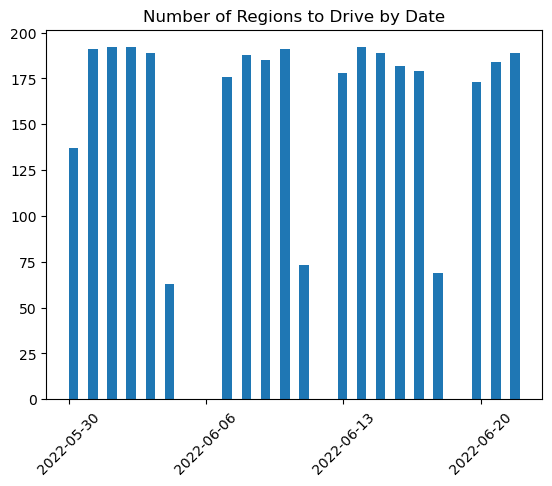

In [17]:
plt.hist(regiondate["Date"], bins=47)
plt.title('Number of Regions to Drive by Date')
# plt.xlabel('')
# plt.ylabel('')

# Set x-axis ticks to every Monday
plt.gca().xaxis.set_major_locator(mdates.WeekdayLocator(byweekday=mdates.MO))
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d'))

# Rotate x-axis labels
plt.xticks(rotation=45,)

# Add legend
# plt.legend()

plt.show()


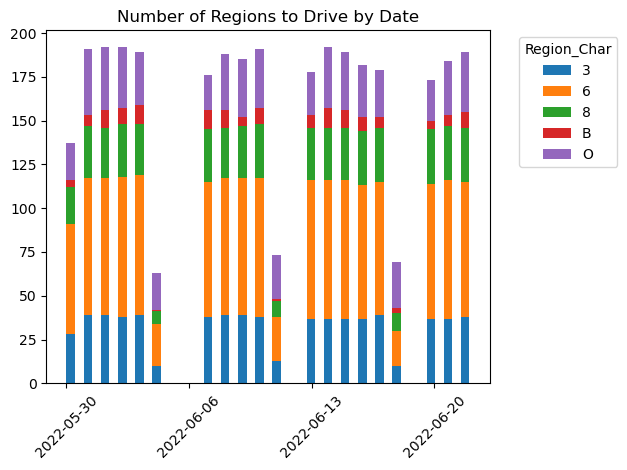

In [18]:
# Group data by Route_Char
grouped = [
    group["Date"]
    for _, group in regiondate.groupby("Region_Char")
]

labels = regiondate["Region_Char"].unique()

# Plot histogram
plt.hist(grouped, bins=47, stacked=True, label=labels)

plt.title('Number of Regions to Drive by Date')
# plt.xlabel('')
# plt.ylabel('')
# plt.legend(title='Route_Char')
plt.legend(title='Region_Char', bbox_to_anchor=(1.05, 1), loc='upper left')

# Set x-axis ticks to every Monday
plt.gca().xaxis.set_major_locator(mdates.WeekdayLocator(byweekday=mdates.MO))
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d'))

# Rotate x-axis labels
plt.xticks(rotation=45)

plt.tight_layout()
plt.show()


### Adinda : Region-Date-Request combinations

In [19]:
regiondaterequest = request_df.groupby(["Region_Char","RouteId","Date","dir","Time",
                                        "request_day_route_order","request_day_route_is_last",
                                        "OptimizationRequestId","ConfigurationName"])['dir'].count().reset_index(name='CountLocs')
regiondaterequest.shape

(18010, 10)

In [22]:
selection = "0521_621-20220616"
# selection = "0521_670-20220620"
# regiondaterequest.loc[regiondaterequest["dir"] == selection].head(15)
regiondaterequest.loc[regiondaterequest["dir"] == selection].loc[:,["RouteId","Date","Time","OptimizationRequestId",
                                                                    "ConfigurationName", "request_day_route_order",
                                                                    "request_day_route_is_last"]].head(15)

,RouteId,Date,Time,OptimizationRequestId,ConfigurationName,request_day_route_order,request_day_route_is_last
5736,0521_621,2022-06-16,05:14:18,f952e93a-5019-47f3-aa0f-08a392f47c8c,CreateSequence,1.0,False
5737,0521_621,2022-06-16,05:16:16,c278320d-4e6c-48f0-ae6d-aa62d43f88a0,CreateSequence,2.0,False
5738,0521_621,2022-06-16,06:00:23,33701bd0-f0d6-4a41-856c-11f52e2c2b98,AddToSequence,3.0,False
5739,0521_621,2022-06-16,06:22:00,f1358c3a-8100-4903-9633-2b4639590272,EstimateTime,4.0,False
5740,0521_621,2022-06-16,06:25:13,a43f658a-5838-4b4f-9fa7-0f204c029d47,EstimateTime,5.0,False
5741,0521_621,2022-06-16,06:46:15,44ae9ef4-a8b3-4011-a19d-776a6b4a8f43,EstimateTime,6.0,False
5742,0521_621,2022-06-16,06:49:35,9759e2ca-0d77-4db5-85da-dced7a6a95b3,EstimateTime,7.0,True


In [23]:
regiondaterequest_driven = regiondaterequest.query('request_day_route_is_last == True')
regiondaterequest_driven.shape

(3311, 10)

In [24]:
regiondaterequest_driven.to_excel("../data/intermediate/regiondaterequest_driven.xlsx")

In [25]:
a_mean = regiondaterequest_driven["request_day_route_order"].mean()
a_median = regiondaterequest_driven["request_day_route_order"].median()
print("mean", a_mean, "/ median", a_median)

mean 5.437028088190879 / median 5.0


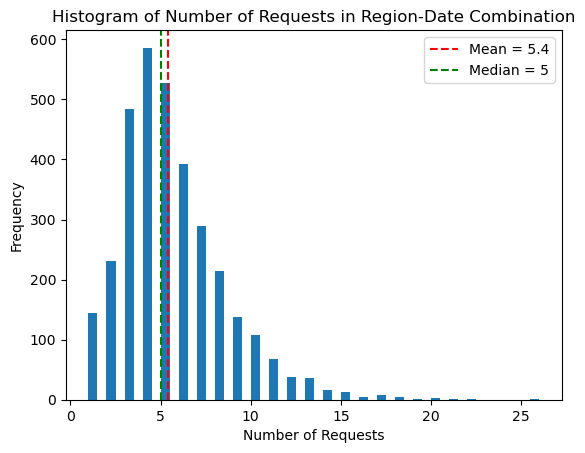

In [26]:
plt.hist(regiondaterequest_driven["request_day_route_order"], bins=50)
plt.title('Histogram of Number of Requests in Region-Date Combination')
plt.xlabel('Number of Requests')
plt.ylabel('Frequency')
plt.axvline(a_mean, color='red', linestyle='dashed', linewidth=1.5, label=f'Mean = {a_mean:.1f}')
plt.axvline(a_median, color='green', linestyle='dashed', linewidth=1.5, label=f'Median = {a_median:.0f}')


# Add legend
plt.legend()

plt.show()

In [28]:
b_mean = regiondaterequest_driven["CountLocs"].mean()
b_median = regiondaterequest_driven["CountLocs"].median()
print("mean", b_mean, "/ median", b_median)

mean 109.06644518272425 / median 115.0


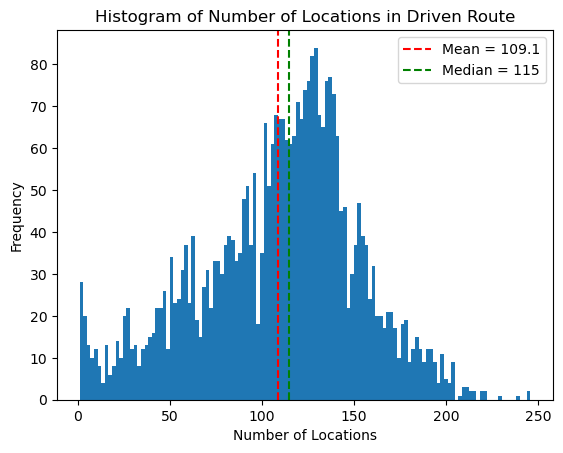

In [29]:
plt.hist(regiondaterequest_driven["CountLocs"], bins=125)
plt.title('Histogram of Number of Locations in Driven Route')
plt.xlabel('Number of Locations')
plt.ylabel('Frequency')

plt.axvline(b_mean, color='red', linestyle='dashed', linewidth=1.5, label=f'Mean = {b_mean:.1f}')
plt.axvline(b_median, color='green', linestyle='dashed', linewidth=1.5, label=f'Median = {b_median:.0f}')


# Add legend
plt.legend()

plt.show()

In [38]:
regiondaterequest_driven.loc[regiondaterequest_driven["count"] <= 2].shape

(28, 9)

In [ ]:
regiondaterequest_driven.loc[regiondaterequest_driven["count"] >= 240].shape

In [30]:
regiondaterequest_driven["ConfigurationName"].value_counts()

ConfigurationName
EstimateTime      3082
CreateSequence     172
AddToSequence       57
Name: count, dtype: int64

In [31]:
regiondaterequest_driven1 = regiondaterequest_driven.loc[regiondaterequest_driven["ConfigurationName"] == "EstimateTime"].copy()
regiondaterequest_driven1.shape

(3082, 10)

In [33]:
c_mean = regiondaterequest_driven1["CountLocs"].mean()
c_median = regiondaterequest_driven1["CountLocs"].median()
print("mean", c_mean, "/ median", c_median)

mean 111.85009733939 / median 116.0


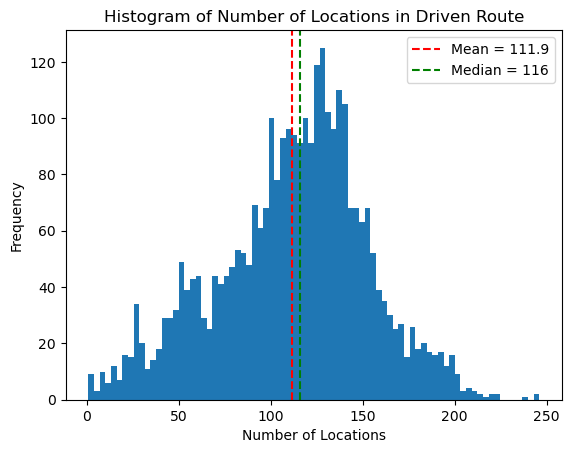

In [36]:
plt.hist(regiondaterequest_driven1["CountLocs"], bins=80)
plt.title('Histogram of Number of Locations in Driven Route')
plt.xlabel('Number of Locations')
plt.ylabel('Frequency')

plt.axvline(c_mean, color='red', linestyle='dashed', linewidth=1.5, label=f'Mean = {c_mean:.1f}')
plt.axvline(c_median, color='green', linestyle='dashed', linewidth=1.5, label=f'Median = {c_median:.0f}')


# Add legend
plt.legend()

plt.show()

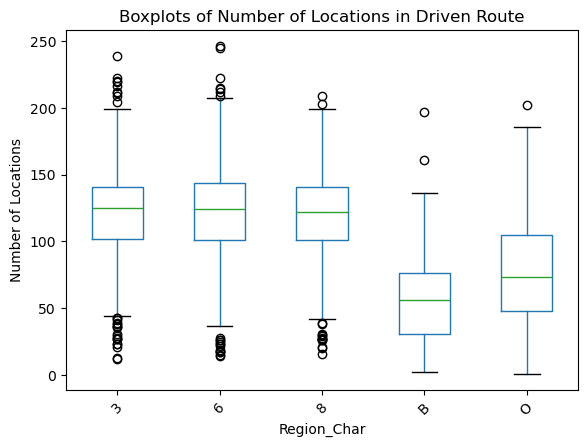

In [40]:
regiondaterequest_driven1.boxplot(column='CountLocs', by='Region_Char', grid=False)
plt.title("Boxplots of Number of Locations in Driven Route")
plt.suptitle("")  # removes the automatic Pandas title
plt.ylabel('Number of Locations')
plt.xticks(rotation=45)
plt.show()

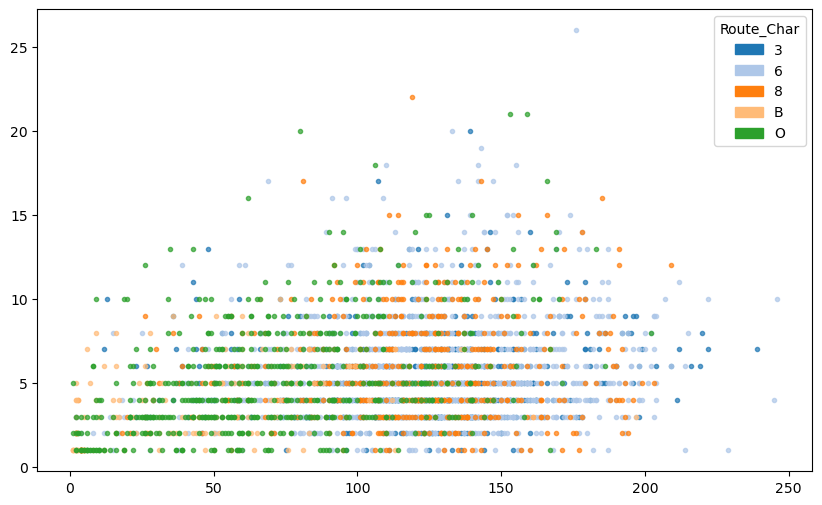

In [101]:
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

fig, ax = plt.subplots(figsize=(10, 6))

colors = plt.cm.tab20.colors  # or use a color palette
legend_patches = []

for i, (route, group) in enumerate(regiondaterequest_driven.groupby('Route_Char')):
    color = colors[i % len(colors)]
    ax.scatter(group['count'], group['request_day_route_order'], alpha=0.7, marker='.', color=color)
    
    # Add visible patch for legend
    patch = mpatches.Patch(color=color, label=route)
    legend_patches.append(patch)

ax.legend(handles=legend_patches, title="Route_Char")
plt.show()

In [56]:
test = regiondaterequest_driven1.groupby(['Route_Char','RouteId'])['count'].agg(['min', 'max']).reset_index()
test['diff'] = test['max'] - test['min']
test.sort_values(by=(["diff"]), ascending=False, inplace=True)
test.shape

(226, 5)

In [57]:
test.head()

,Route_Char,RouteId,min,max,diff
113,6,0521_693,23,246,223
117,6,0521_697,44,245,201
26,3,0521_361,44,239,195
151,B,0521_B02,7,197,190
91,6,0521_669,26,203,177


## Finding clusters: Top approach: where are city centers across all delivery points
We look at all stops in the dataset and see which coordinates light up the most using Grid in scatter

In [41]:
#how many points per route_id (Undoubled)
request_df_driven = request_df.query('request_day_route_is_last==True')
request_df_driven.shape

(361119, 27)

In [42]:
print(np.min(request_df_driven['lat']), np.max(request_df_driven['lat']))
print(np.min(request_df_driven['long']), np.max(request_df_driven['long']))
# no need to scale  (values are between 0 and 1, but you see there's a strong center, zoomed in above. )

0.4271502653342023 0.7746185173426138
0.0193215188580476 0.6108202888928611


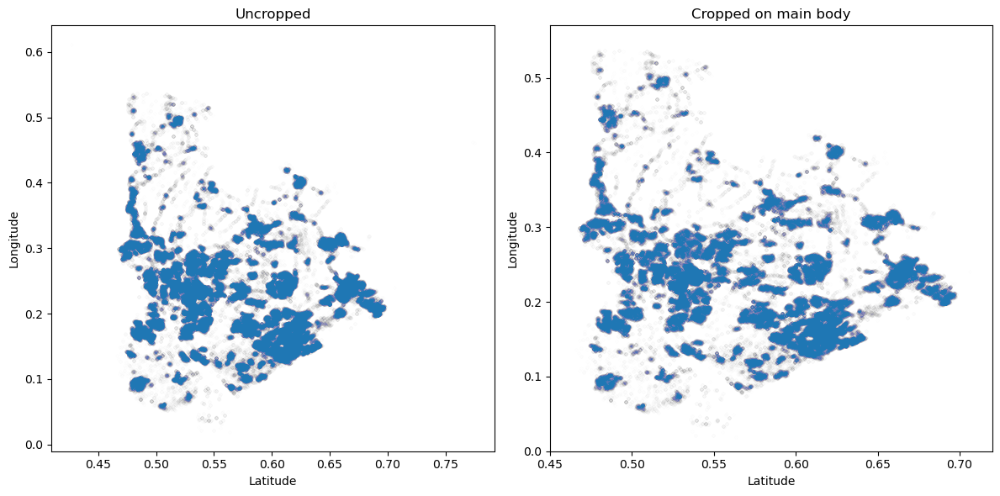

In [49]:
fig, axs = plt.subplots(1, 2, figsize=(12, 6))
axs[0].scatter(x=request_df_driven['lat'], y=request_df_driven['long'], alpha=0.005, marker='.')
axs[0].set_title('Uncropped')
axs[0].set_xlabel('Latitude')
axs[0].set_ylabel('Longitude')
axs[1].scatter(x=request_df_driven['lat'], y=request_df_driven['long'], alpha=0.005, marker='.')
axs[1].set_xlim(0.45, 0.72)
axs[1].set_ylim(0, 0.57)
axs[1].set_title('Cropped on main body')
axs[1].set_xlabel('Latitude')
axs[1].set_ylabel('Longitude')
plt.tight_layout()

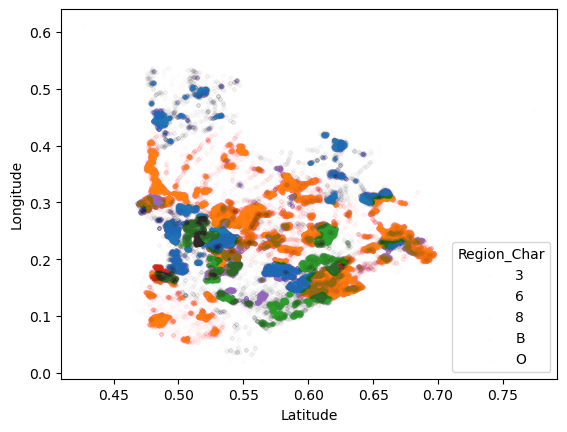

In [45]:
fig, ax = plt.subplots()
for route, group in request_df_driven.groupby('Region_Char'):
    ax.scatter(group['lat'], group['long'], alpha=0.005, marker='.', label=route)

ax.legend(title='Region_Char')  # optional
ax.set_xlabel('Latitude')
ax.set_ylabel('Longitude')
plt.show()


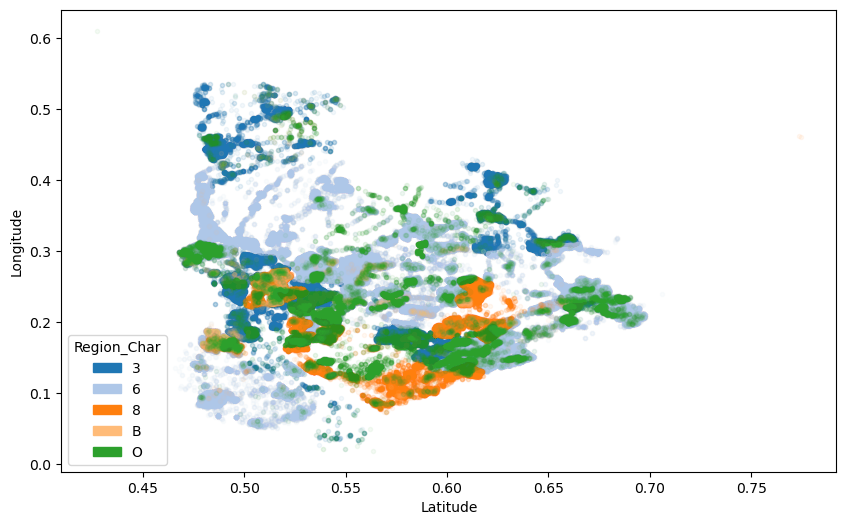

In [47]:
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

fig, ax = plt.subplots(figsize=(10, 6))

colors = plt.cm.tab20.colors  # or use a color palette
legend_patches = []

for i, (route, group) in enumerate(request_df_driven.groupby('Region_Char')):
    color = colors[i % len(colors)]
    ax.scatter(group['lat'], group['long'], alpha=0.05, marker='.', color=color)
    
    # Add visible patch for legend
    patch = mpatches.Patch(color=color, label=route)
    legend_patches.append(patch)

ax.legend(handles=legend_patches, title="Region_Char")
ax.set_xlabel('Latitude')
ax.set_ylabel('Longitude')
plt.show()


Very high density of the blue dots - we need to add in the calculated is_max values from the server_df to get the actual driven routes in stead of the same coordinate being calculated multiple times. This will decrease density of the markers. Added benefit is that it will reduce computation time as you'll have less points in request_df_driven vs request_df

In [9]:
## Good, now we work with 18.47% of the data
len(request_df_driven)/len(request_df)

0.17026437918065226

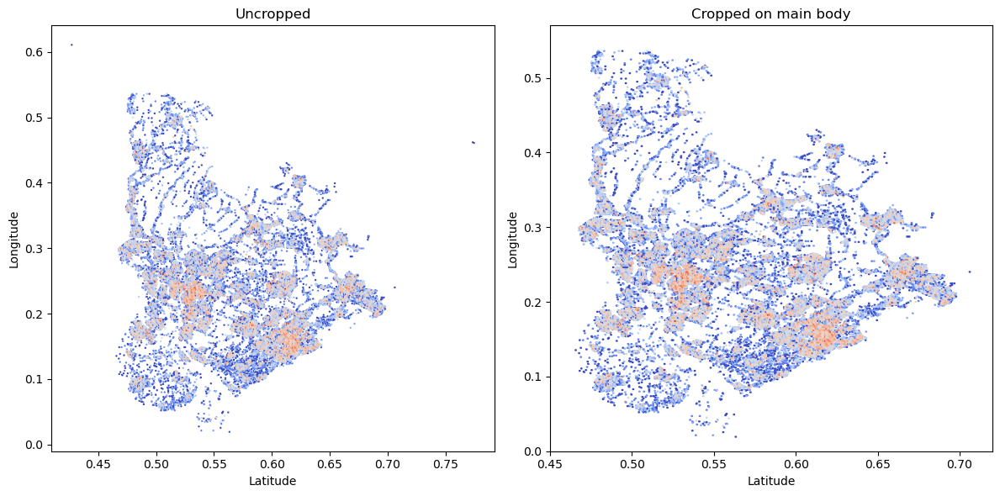

In [10]:
gs = 500  #grid size in plot

fig, axs = plt.subplots(1, 2, figsize=(12, 6))
# Left plot: Uncropped hexbin
axs[0].hexbin(request_df_driven['lat'], request_df_driven['long'], gridsize=gs, cmap="coolwarm", bins="log")
axs[0].set_title('Uncropped')
axs[0].set_xlabel('Latitude')
axs[0].set_ylabel('Longitude')
axs[0].grid(False)
# Right plot: Cropped on cluster
axs[1].hexbin(request_df_driven['lat'], request_df_driven['long'], gridsize=gs, cmap="coolwarm", bins="log")
axs[1].set_xlim(0.45, 0.72) 
axs[1].set_ylim(0, 0.57)
axs[1].set_title('Cropped on main body')
axs[1].set_xlabel('Latitude')
axs[1].set_ylabel('Longitude')
axs[1].grid(False)
# Adjust layout
plt.tight_layout()

In [11]:
#sampled_df required for memory footprint

sampled_driven = request_df_driven.sample(frac=0.75)
coordinates = sampled_driven[['lat', 'long']].values
#no need to scale - values are already between 0 and 1
dbscan = DBSCAN(eps=0.00075, min_samples=5)
clusters = dbscan.fit_predict(coordinates)
sampled_driven['cluster'] = clusters
num_clusters = len(set(clusters)) - (1 if -1 in clusters else 0)
fig = px.scatter(
    sampled_driven,
    x='lat',
    y='long',
    color='cluster',
    color_continuous_scale='Viridis',
    title='DBSCAN Clustering of Coordinates',
    labels={'lat': 'Latitude', 'long': 'Longitude', 'cluster': 'Cluster Label'},
    height=PH,
    width=PW
)

fig.show()

## Are routes zone-specific:
let's change the color of a scatterdot by the color of the route_id - the values are a bit high( 227 routeids, but this should give us some indication)

In [106]:
request_df_driven.RouteId.value_counts()    #227 route ids, a bit much, but so be it

RouteId
0521_363    3308
0521_690    3161
0521_641    3073
0521_876    2960
0521_361    2920
            ... 
0521_O51      31
0521_B14      17
0521_O55       8
0521_O32       4
0521_300       2
Name: count, Length: 232, dtype: int64

In [48]:

h.highlight_route(request_df_driven,'0521_361', PW, PH)
# h.highlight_route(request_df_driven.query('Date == "2022-06-20"'),'0521_361', PW, PH)

You can play with the function above, it's clear that routes do not shift drastically, they are focussed on a specific area of the larger dataset.

In [14]:
## WARNING: the id column from the JSON file is not guaranteed to be unique!!!
# i went back to step1 and added a an incrementing number per file. the order
# of the stops is as the addresses are given in the list of objects in each
# JSON file. > 'stop_order' is unique combined with file_uuid.
# this stop_order value is used to build the route (stop1 > stop2 > stop3...)
request_df.id.nunique == len(request_df)

False

## Distances in routes: 

In [15]:
request_df

,file_uuid,configurationName,id,lat,long,start_time,end_time,server_task_number,stop_order,dir,...,Date,Time,OptimizationRequestId,RouteId,TriggerType,ConfigurationName,NumberOfTasks,NumberOfTasksInInputPlan,request_day_route_order,request_day_route_is_last
0,41931cd2-8975-4a64-9197-d16abe871bb7,CreateSequence,394,0.565826,0.221868,2022-06-17T07:30:00,2022-06-17T18:00:00,2,1,0521_300-20220617,...,2022-06-17 00:00:00,1900-01-01 05:57:33.231000,41931cd2-8975-4a64-9197-d16abe871bb7,0521_300,FullOptimization,CreateSequence,2.0,0.0,1.0,False
1,41931cd2-8975-4a64-9197-d16abe871bb7,CreateSequence,395,0.565826,0.221868,2022-06-17T08:00:00,2022-06-17T17:00:00,1,2,0521_300-20220617,...,2022-06-17 00:00:00,1900-01-01 05:57:33.231000,41931cd2-8975-4a64-9197-d16abe871bb7,0521_300,FullOptimization,CreateSequence,2.0,0.0,1.0,False
2,5737d4ef-23e9-4832-8bb5-24340a176e31,CreateSequence,384,0.565826,0.221868,2022-06-17T07:30:00,2022-06-17T23:59:00,2,1,0521_300-20220617,...,2022-06-17 00:00:00,1900-01-01 08:50:02.773000,5737d4ef-23e9-4832-8bb5-24340a176e31,0521_300,FullOptimization,CreateSequence,2.0,0.0,2.0,False
3,5737d4ef-23e9-4832-8bb5-24340a176e31,CreateSequence,385,0.565826,0.221868,2022-06-17T08:00:00,2022-06-17T17:00:00,1,2,0521_300-20220617,...,2022-06-17 00:00:00,1900-01-01 08:50:02.773000,5737d4ef-23e9-4832-8bb5-24340a176e31,0521_300,FullOptimization,CreateSequence,2.0,0.0,2.0,False
4,34f409b3-9f92-4720-9926-48ca1cbf6f90,CreateSequence,388,0.572716,0.233306,2022-06-17T07:30:00,2022-06-17T23:59:00,2,1,0521_300-20220617,...,2022-06-17 00:00:00,1900-01-01 09:24:16.831000,34f409b3-9f92-4720-9926-48ca1cbf6f90,0521_300,FullOptimization,CreateSequence,2.0,0.0,3.0,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2120926,8a8e6d6b-045c-44bd-9085-cf2d5ec7a6d1,EstimateTime,63699,0.480072,0.301707,2022-06-22T07:30:00,2022-06-22T23:59:00,135,135,0521_O69-20220622,...,2022-06-22 00:00:00,1900-01-01 08:38:33.987000,8a8e6d6b-045c-44bd-9085-cf2d5ec7a6d1,0521_O69,TimeCalculation,EstimateTime,139.0,139.0,5.0,True
2120927,8a8e6d6b-045c-44bd-9085-cf2d5ec7a6d1,EstimateTime,63698,0.479680,0.301925,2022-06-22T07:30:00,2022-06-22T23:59:00,136,136,0521_O69-20220622,...,2022-06-22 00:00:00,1900-01-01 08:38:33.987000,8a8e6d6b-045c-44bd-9085-cf2d5ec7a6d1,0521_O69,TimeCalculation,EstimateTime,139.0,139.0,5.0,True
2120928,8a8e6d6b-045c-44bd-9085-cf2d5ec7a6d1,EstimateTime,63697,0.479792,0.300703,2022-06-22T07:30:00,2022-06-22T23:59:00,137,137,0521_O69-20220622,...,2022-06-22 00:00:00,1900-01-01 08:38:33.987000,8a8e6d6b-045c-44bd-9085-cf2d5ec7a6d1,0521_O69,TimeCalculation,EstimateTime,139.0,139.0,5.0,True
2120929,8a8e6d6b-045c-44bd-9085-cf2d5ec7a6d1,EstimateTime,63696,0.481527,0.300490,2022-06-22T07:30:00,2022-06-22T23:59:00,138,138,0521_O69-20220622,...,2022-06-22 00:00:00,1900-01-01 08:38:33.987000,8a8e6d6b-045c-44bd-9085-cf2d5ec7a6d1,0521_O69,TimeCalculation,EstimateTime,139.0,139.0,5.0,True


In [49]:
#Feature engineering function adds columns that caclulate distances in between stops and a total ODO per route per day
request_df = f.calculate_distances(request_df, 'stop_order')


100%|██████████| 18010/18010 [00:47<00:00, 378.14it/s]


In [51]:
#see if extra cols are present => yes: carry on
request_df.head()

,file_uuid,configurationName,id,lat,long,start_time,end_time,server_task_number,stop_order,dir,...,TriggerType,ConfigurationName,NumberOfTasks,NumberOfTasksInInputPlan,request_day_route_order,request_day_route_is_last,Region_Char,dist_since_prev,dist_cumulative,dist_to_next_stop
610693,0000eb3f-b669-476c-bec3-858b8286e193,CreateSequence,71108,0.493993,0.315449,2022-06-09T07:30:00,2022-06-09T23:59:00,27,1,0521_612-20220609,...,FullOptimization,CreateSequence,204.0,0.0,1.0,False,6,0.000000,0.000000,0.000949
610694,0000eb3f-b669-476c-bec3-858b8286e193,CreateSequence,71080,0.494289,0.314548,2022-06-09T07:30:00,2022-06-09T17:00:00,14,2,0521_612-20220609,...,FullOptimization,CreateSequence,204.0,0.0,1.0,False,6,0.000949,0.000949,0.003482
610695,0000eb3f-b669-476c-bec3-858b8286e193,CreateSequence,71048,0.493936,0.311083,2022-06-09T07:30:00,2022-06-09T17:00:00,176,3,0521_612-20220609,...,FullOptimization,CreateSequence,204.0,0.0,1.0,False,6,0.003482,0.004431,0.005125
610696,0000eb3f-b669-476c-bec3-858b8286e193,CreateSequence,71177,0.491165,0.315395,2022-06-09T00:00:00,2022-06-09T23:59:00,134,4,0521_612-20220609,...,FullOptimization,CreateSequence,204.0,0.0,1.0,False,6,0.005125,0.009556,0.001414
610697,0000eb3f-b669-476c-bec3-858b8286e193,CreateSequence,71049,0.490411,0.316590,2022-06-09T07:30:00,2022-06-09T23:59:00,177,5,0521_612-20220609,...,FullOptimization,CreateSequence,204.0,0.0,1.0,False,6,0.001414,0.010970,0.001499


### distances: Interstop distance

Text(0.5, 1.0, 'Interstop distances (logscaled)')

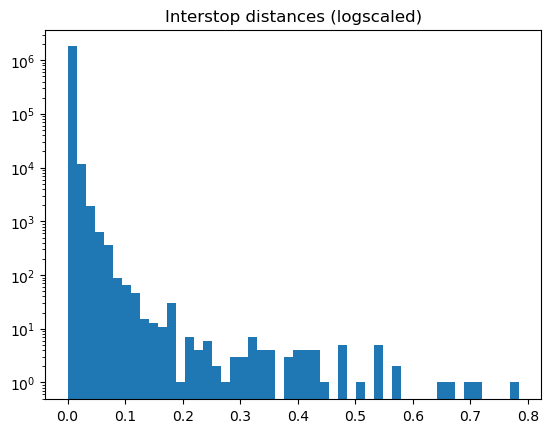

In [18]:
## average inter-stop distance: 
plt.hist(
    request_df.query("dist_since_prev > 0 ").dist_since_prev, 
    bins = 50, 
    log = True
    )
plt.title('Interstop distances (logscaled)')
#BEWARE: y-xis is in log ==> looks smooth is again witha heavy tail!!!!! 

heavy tail; let's plot out distances between 0 and 0.1

Text(0.5, 1.0, 'Interstop distances (logscaled)')

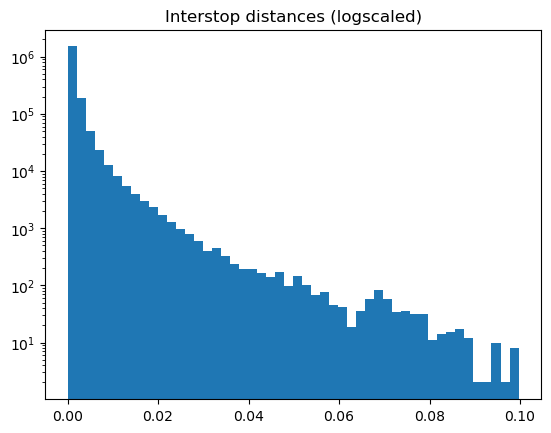

In [19]:
plt.hist(
    request_df.query("dist_since_prev > 0 and dist_since_prev <= 0.1").dist_since_prev, 
    bins = 50, 
    log = True
    )
plt.title('Interstop distances (logscaled)')
#BEWARE: y-xis is in log ==> looks smooth is again witha heavy tail!!!!! 


### distances: Total ODO

Text(0.5, 1.0, 'Total route distance (logscaled)')

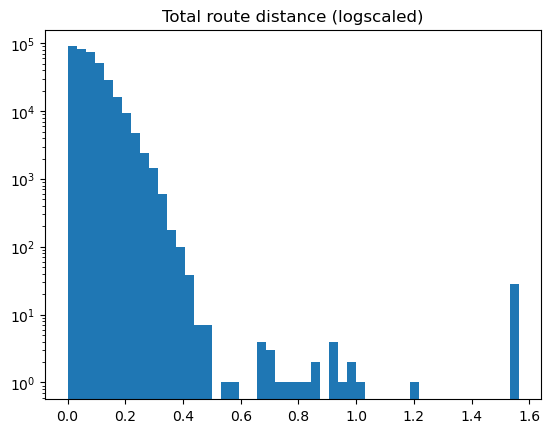

In [20]:
plt.hist(
    request_df.query('request_day_route_is_last==True').dist_cumulative,
    bins = 50, 
    log = True
    )
plt.title('Total route distance (logscaled)')
#BEWARE: y-xis is in log ==> looks smooth is again witha heavy tail!!!!! 

In [21]:
# TODO
"""
    We need to figure out if the routes are complete or not? 
    - is the last point in the route the last package to drop or is it a depot?
    - Is the first point in the ruote the depot? 

    what we need to doncretely in pseudocode: 
    1) see if df[0][lat/long] == df[-1][lat/long]
    2) freq (lat+.+long) 

"""

'\n    We need to figure out if the routes are complete or not? \n    - is the last point in the route the last package to drop or is it a depot?\n    - Is the first point in the ruote the depot? \n\n    what we need to doncretely in pseudocode: \n    1) see if df[0][lat/long] == df[-1][lat/long]\n    2) freq (lat+.+long) \n\n'

## Comparing first route version with driven route version: 
We need to compare the first version of a route with the final driven version to find which points got deleted from a route. 

In [22]:
request_df

,file_uuid,configurationName,id,lat,long,start_time,end_time,server_task_number,stop_order,dir,...,RouteId,TriggerType,ConfigurationName,NumberOfTasks,NumberOfTasksInInputPlan,request_day_route_order,request_day_route_is_last,dist_since_prev,dist_cumulative,dist_to_next_stop
610693,0000eb3f-b669-476c-bec3-858b8286e193,CreateSequence,71108,0.493993,0.315449,2022-06-09T07:30:00,2022-06-09T23:59:00,27,1,0521_612-20220609,...,0521_612,FullOptimization,CreateSequence,204.0,0.0,1.0,False,0.000000,0.000000,0.000949
610694,0000eb3f-b669-476c-bec3-858b8286e193,CreateSequence,71080,0.494289,0.314548,2022-06-09T07:30:00,2022-06-09T17:00:00,14,2,0521_612-20220609,...,0521_612,FullOptimization,CreateSequence,204.0,0.0,1.0,False,0.000949,0.000949,0.003482
610695,0000eb3f-b669-476c-bec3-858b8286e193,CreateSequence,71048,0.493936,0.311083,2022-06-09T07:30:00,2022-06-09T17:00:00,176,3,0521_612-20220609,...,0521_612,FullOptimization,CreateSequence,204.0,0.0,1.0,False,0.003482,0.004431,0.005125
610696,0000eb3f-b669-476c-bec3-858b8286e193,CreateSequence,71177,0.491165,0.315395,2022-06-09T00:00:00,2022-06-09T23:59:00,134,4,0521_612-20220609,...,0521_612,FullOptimization,CreateSequence,204.0,0.0,1.0,False,0.005125,0.009556,0.001414
610697,0000eb3f-b669-476c-bec3-858b8286e193,CreateSequence,71049,0.490411,0.316590,2022-06-09T07:30:00,2022-06-09T23:59:00,177,5,0521_612-20220609,...,0521_612,FullOptimization,CreateSequence,204.0,0.0,1.0,False,0.001414,0.010970,0.001499
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1766866,ffff6e26-f5a6-423e-b4dc-40bfd82cce12,AddToSequence,65498,0.578363,0.098513,2022-06-17T07:30:00,2022-06-17T23:59:00,100,100,0521_890-20220617,...,0521_890,AdditionalOrders,AddToSequence,104.0,102.0,2.0,False,0.000000,0.180777,0.000000
1766867,ffff6e26-f5a6-423e-b4dc-40bfd82cce12,AddToSequence,65493,0.578363,0.098513,2022-06-17T07:30:00,2022-06-17T23:59:00,101,101,0521_890-20220617,...,0521_890,AdditionalOrders,AddToSequence,104.0,102.0,2.0,False,0.000000,0.180777,0.000441
1766868,ffff6e26-f5a6-423e-b4dc-40bfd82cce12,AddToSequence,65408,0.578175,0.098912,2022-06-17T07:30:00,2022-06-17T23:59:00,102,102,0521_890-20220617,...,0521_890,AdditionalOrders,AddToSequence,104.0,102.0,2.0,False,0.000441,0.181218,0.000113
1766869,ffff6e26-f5a6-423e-b4dc-40bfd82cce12,AddToSequence,65388,0.578287,0.098896,2022-06-17T07:30:00,2022-06-17T23:59:00,103,103,0521_890-20220617,...,0521_890,AdditionalOrders,AddToSequence,104.0,102.0,2.0,False,0.000113,0.181331,0.000000


In [ ]:
init_points = set()
final_points = set()
request_df['id'] = request_df['id'].astype('str') ## mixed types ==> be careful because 123 !== '123'
for _, df in request_df.groupby('dir'):
    #Time is the timestamp coming from serverlog: compare first request wiht last non-PM request
    # REMEMBER THAT: PM requests where filtered out already.
    first_request_timestamp = df['Time'].min()
    last_request_timestamp = df['Time'].max()
    #get the first and last request as dfs: 
    first_request_df = df.loc[df['Time'] == first_request_timestamp]
    last_request_df = df.loc[df['Time'] == last_request_timestamp]
    #Only interested in dropped for generating MLs on dropping stops. 
    #TODO ==> Someone: run statistics on common, added, dropped. 
    common, added, dropped = f.stop_diffs(first_request_df, last_request_df)
    init_points.update(first_request_df['id'].to_list())
    final_points.update(last_request_df['id'].to_list())


In [39]:
dropped_from_init = init_points - final_points

# Optionally, print or log the result
print(f"{len(dropped_from_init)} points in planning tool but not served by any of the driven routes:", dropped_from_init)


11338 points in planning tool but not served by any of the driven routes: {'190208', '45811', '344761', '20947', '105970', '173142', '98004', '125118', '47124', '170869', '27422', '118625', '137840', '45998', '236183', '97452', '345226', '92266', '99165', '91308', '100050', '52032', '172643', '85865', '188568', '148219', '106227', '187179', '155057', '194675', '52102', '190267', '212688', '99370', '171588', '193152', '188119', '190346', '184081', '400707', '154850', '247122', '108099', '186469', '98718', '99877', '221893', '172685', '52445', '145849', '142820', '98728', '184126', '180776', '175358', '194243', '171490', '174307', '230096', '182315', '136078', '109196', '161780', '96109', '247036', '347652', '189480', '38116', '187110', '146714', '153896', '174361', '159735', '154860', '73597', '27637', '343528', '190104', '108016', '264836', '112208', '135669', '191282', '85871', '32502', '172609', '135618', '110550', '141903', '172560', '171882', '192577', '21088', '171513', '24276', '